Epoch 1/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 343s 685ms/step - accuracy: 0.8523 - loss: 0.3525 - val_accuracy: 0.9347 - val_loss: 0.1693 - learning_rate: 0.0010
Epoch 2/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 1s 525us/step - accuracy: 0.9688 - loss: 0.0594 - val_accuracy: 1.0000 - val_loss: 0.0085 - learning_rate: 0.0010
Epoch 3/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 312s 641ms/step - accuracy: 0.9288 - loss: 0.1990 - val_accuracy: 0.9486 - val_loss: 0.1321 - learning_rate: 0.0010
Epoch 4/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 1s 415us/step - accuracy: 0.9062 - loss: 0.1725 - val_accuracy: 0.8571 - val_loss: 0.1681 - learning_rate: 0.0010
Epoch 5/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 279s 573ms/step - accuracy: 0.9352 - loss: 0.1709 - val_accuracy: 0.9452 - val_loss: 0.1374 - learning_rate: 0.0010
Epoch 6/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 1s 247us/step - accuracy: 0.9688 - loss: 0.1389 - val_accuracy: 1.0000 - val_loss: 0.0159 - learning_rate: 0.0010
Epoch 7/15
484/484 ━━━━━━━━━━━━━━━━━━━━ 273s 561ms/step - accuracy: 0.

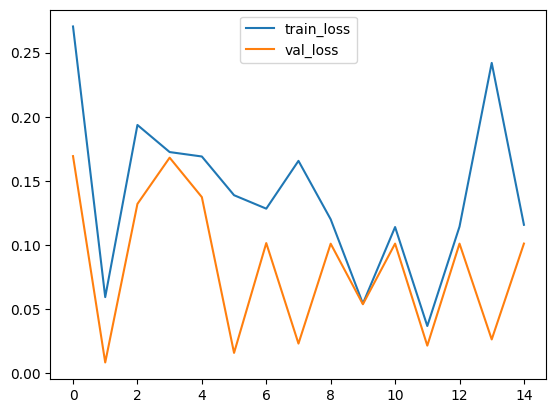

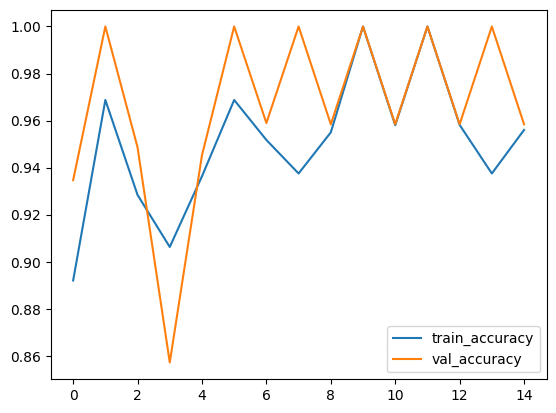

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, LeakyReLU
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import LearningRateScheduler
from sklearn.metrics import f1_score, confusion_matrix, classification_report

# Suppress warnings for cleaner output
import warnings
warnings.filterwarnings("ignore")

# Load image data
# Load filenames of images with and without masks from respective directories
with_mask_images = os.listdir('data/with_mask')
without_mask_images = os.listdir('data/without_mask')

# Prepare labels
# Assign labels: 1 for "with mask" and 0 for "without mask"
with_mask_labels = [1] * len(with_mask_images)
without_mask_labels = [0] * len(without_mask_images)
labels = with_mask_labels + without_mask_labels

# Function to preprocess the images and labels
def preprocess_images(image_paths, base_path):
    data = []
    for img_file in image_paths:
        # Open image file using PIL
        image = Image.open(os.path.join(base_path, img_file))
        # Resize image to 128x128
        image = image.resize((128, 128))
        # Convert image to RGB format
        image = image.convert('RGB')
        # Convert image to numpy array
        image = np.array(image)
        # Append the preprocessed image to the data list
        data.append(image)
    return np.array(data)

# Paths to the directories containing the images
with_mask_path = 'data/with_mask/'
without_mask_path = 'data/without_mask/'

# Preprocess the images
data_with_mask = preprocess_images(with_mask_images, with_mask_path)
data_without_mask = preprocess_images(without_mask_images, without_mask_path)

# Combine preprocessed data and labels
X = np.concatenate([data_with_mask, data_without_mask], axis=0)
Y = np.array(labels)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Normalize the image data by scaling pixel values to the range [0, 1]
X_train = X_train / 255.0
X_test = X_test / 255.0

# Data augmentation
# Create an ImageDataGenerator for augmenting the training data with transformations
train_datagen = ImageDataGenerator(
    rotation_range=10,          # Random rotation
    width_shift_range=0.1,      # Random width shift
    height_shift_range=0.1,     # Random height shift
    shear_range=0.1,            # Random shear
    zoom_range=0.1,             # Random zoom
    horizontal_flip=True,       # Random horizontal flip
    fill_mode='nearest'         # Fill mode for new pixels
)

# Create an ImageDataGenerator for the validation data (without augmentation)
val_datagen = ImageDataGenerator()

# Generate augmented data for training
train_generator = train_datagen.flow(X_train, y_train, batch_size=32)
# Generate validation data
val_generator = val_datagen.flow(X_test, y_test, batch_size=32)

# Calculate class weights to handle class imbalance
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights = dict(enumerate(class_weights))

# Define a learning rate scheduler to reduce learning rate after a certain number of epochs
def lr_schedule(epoch, lr):
    if epoch > 5:
        lr = lr * 0.1
    return lr

lr_scheduler = LearningRateScheduler(lr_schedule)

# Build a more complex model with Dropout to prevent overfitting
model = Sequential()
model.add(Conv2D(32, kernel_size=(3,3), input_shape=(128, 128, 3)))
model.add(LeakyReLU(alpha=0.1))  # Leaky ReLU activation function
model.add(MaxPooling2D(pool_size=(2, 2)))  # MaxPooling layer to reduce spatial dimensions
model.add(Conv2D(64, kernel_size=(3, 3)))
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(128, kernel_size=(3, 3)))
model.add(LeakyReLU(alpha=0.1))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())  # Flatten the 2D output to 1D for Dense layers
model.add(Dense(128))  # Fully connected layer with 128 neurons
model.add(LeakyReLU(alpha=0.1))
model.add(Dropout(0.5))  # Dropout layer with 50% rate to prevent overfitting
model.add(Dense(1, activation='sigmoid'))  # Output layer with sigmoid activation for binary classification

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model with class weights and learning rate scheduler
history = model.fit(
    train_generator,
    steps_per_epoch=len(X_train) // 32,  # Number of steps per epoch
    validation_data=val_generator,
    validation_steps=len(X_test) // 32,  # Number of validation steps
    epochs=15,  # Number of epochs
    class_weight=class_weights,  # Apply class weights to handle class imbalance
    callbacks=[lr_scheduler]  # Apply learning rate scheduler callback
)

# Evaluate the model on the test data
loss, accuracy = model.evaluate(val_generator)
print("Loss is: ", loss)
print("Accuracy is: ", accuracy)

# Calculate the F1 score for the model's predictions
predictions = model.predict(X_test)
predicted_classes = np.where(predictions > 0.5, 1, 0).flatten()
f1 = f1_score(y_test, predicted_classes)
print(f'F1 Score: {f1:.2f}')

# Generate and display the confusion matrix and classification report
conf_matrix = confusion_matrix(y_test, predicted_classes)
print('Confusion Matrix:')
print(conf_matrix)

print('Classification Report:')
print(classification_report(y_test, predicted_classes))

# Plot the training and validation loss over epochs
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.legend()
plt.show()

# Plot the training and validation accuracy over epochs
plt.plot(history.history['accuracy'], label='train_accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.legend()
plt.show()

# Save the trained model to a file for future use
model.save('my_model.keras')


3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 503ms/step


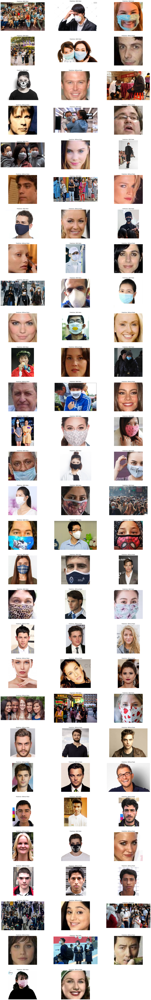

In [3]:
from tensorflow.keras.models import load_model
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# Suppress warnings for cleaner output
import warnings
warnings.filterwarnings("ignore")

# Load the trained model from a saved file
model = load_model('my_model.keras')

# Function to load and preprocess a single image for the model
def load_and_preprocess_image(filepath):
    # Open the image file using PIL
    image = Image.open(filepath)
    # Resize the image to the input size expected by the model (128x128)
    image = image.resize((128, 128))
    # Convert the image to RGB format (in case it's not already)
    image = image.convert('RGB')
    # Convert the image to a numpy array and normalize pixel values to the range [0, 1]
    image = np.array(image) / 255.0
    return image

# Define the directory path where the test images are stored
test_images_dir = 'Test Images'
# Get the full file paths for all images in the test images directory
test_images = [os.path.join(test_images_dir, img) for img in os.listdir(test_images_dir)]

# Load and preprocess all test images
preprocessed_images = np.array([load_and_preprocess_image(img) for img in test_images])

# Make predictions using the loaded model on the preprocessed test images
predictions = model.predict(preprocessed_images)
# Convert predictions to binary class labels (0 or 1) based on a threshold of 0.5
predicted_classes = np.where(predictions > 0.5, 1, 0).flatten()

# Map the predicted classes to human-readable labels
labels = {0: 'Without Mask', 1: 'With Mask'}

# Set up the figure size for plotting the images and their predictions
plt.figure(figsize=(30, 200))

# Calculate the number of images, columns, and rows for the plot
num_images = len(test_images)
num_columns = 3
num_rows = (num_images + num_columns - 1) // num_columns  # Calculate the number of rows needed

# Loop through each test image to display it along with its predicted label
for i in range(num_images):
    # Create a subplot for each image
    plt.subplot(num_rows, num_columns, i + 1)
    # Open the original image file for display
    img = Image.open(test_images[i])
    # Display the image
    plt.imshow(img)
    # Set the title of the subplot to the predicted label
    plt.title(f'Prediction: {labels[predicted_classes[i]]}')
    # Hide the axis for a cleaner look
    plt.axis('off')

# Show the entire plot with all images and their predictions
plt.show()
